# TO DO

- Faire le test avec dataset de 1400 img/mov

**optionnel :**
- Basculer sur sklearn pour voir si plus rapide
- ajouter les précisions par mouvement pour chaque méthode pour voir ce qui marche mieux par mouvements


# Import

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# sklearn
from sklearn.model_selection import train_test_split
import numpy as np
import cv2

# tensorflow and keras
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, MaxPooling2D, Dropout, Input, Conv2D, Flatten, Activation
from tensorflow.keras.models import Model
from tensorflow.keras.metrics import Accuracy, CategoricalAccuracy
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, TensorBoard
from tensorflow.keras.utils import to_categorical
import datetime
import pandas as pd

In [3]:
from neuralart.data import *
from neuralart.fourier import *
from neuralart.baseline import *


In [4]:
print(root)
X_BASE.head()


../raw_data/wikiart/train_val_test_True_200/


,file_name,movement,genre,artist,split,img_path
0,abstract-expressionism_esteban-vicente_copla-1...,abstract,abstract_painting,esteban-vicente,train,../raw_data/wikiart/train_val_test_True_200/tr...
1,abstract-expressionism_sam-francis_untitled-sf...,abstract,abstract_painting,sam-francis,train,../raw_data/wikiart/train_val_test_True_200/tr...
2,abstract-expressionism_brice-marden_cyprian-ev...,abstract,abstract_painting,brice-marden,train,../raw_data/wikiart/train_val_test_True_200/tr...
3,abstract-expressionism_audrey-flack_still-life...,abstract,still_life,audrey-flack,train,../raw_data/wikiart/train_val_test_True_200/tr...
4,action-painting_jackson-pollock_black-white-nu...,abstract,abstract_painting,jackson-pollock,train,../raw_data/wikiart/train_val_test_True_200/tr...


In [5]:
#Baseline class initialization
baseline=Baseline(X_BASE)
print(f' Train set : {baseline.X_train.shape[0]} paintings \
    Val set : {baseline.X_val.shape[0]} paintings \
    Test set : {baseline.X_test.shape[0]} paintings')

 Train set : 1280 paintings     Val set : 160 paintings     Test set : 160 paintings


In [6]:
#Occurence of paintings in Train set
baseline_mov, baseline_gen = baseline.occurence()
print(baseline_mov)
print(baseline_gen)

{'abstract': 0.125, 'color_field_painting': 0.125, 'cubism': 0.125, 'expressionism': 0.125, 'impressionism': 0.125, 'realism': 0.125, 'renaissance': 0.125, 'romanticism': 0.125}
{'abstract_painting': 0.249375, 'cityscape': 0.049375, 'genre_painting': 0.1175, 'illustration': 0.020625, 'landscape': 0.136875, 'nude_painting': 0.03, 'portrait': 0.1725, 'religious_painting': 0.10125, 'sketch_and_study': 0.0625, 'still_life': 0.06}


2021-08-31 09:48:34.034463: I tensorflow/core/platform/cpu_feature_guard.cc:145] This TensorFlow binary is optimized with Intel(R) MKL-DNN to use the following CPU instructions in performance critical operations:  SSE4.1 SSE4.2
To enable them in non-MKL-DNN operations, rebuild TensorFlow with the appropriate compiler flags.
2021-08-31 09:48:34.036675: I tensorflow/core/common_runtime/process_util.cc:115] Creating new thread pool with default inter op setting: 8. Tune using inter_op_parallelism_threads for best performance.


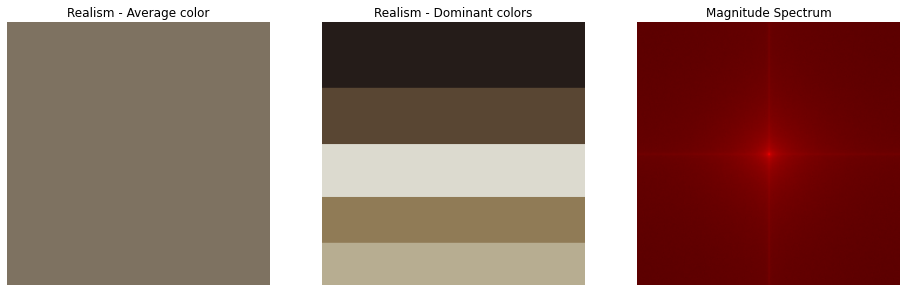

In [7]:

mov='realism'

test=baselines_viz_mov(X_BASE,mov)


In [8]:
basedict=baseline.basedict()

/usr/local/Caskroom/miniforge/base/envs/lewagon/lib/python3.7/site-packages/PIL/Image.py:2914: DecompressionBombWarning: Image size (107327830 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


In [9]:
prediction=baseline.prediction()

In [10]:
prediction

{'avg_color_pred': 0.1375, 'dom_color_pred': 0.21875, 'fft_pred': 0.25}

In [70]:
# Dataframe copy for Data Viz
df_train = baseline.X_train.copy()
df_test=baseline.X_test.copy()
df_train.head()

,file_name,movement,genre,artist,split,img_path
0,abstract-expressionism_esteban-vicente_copla-1...,abstract,abstract_painting,esteban-vicente,train,../raw_data/wikiart/train_val_test_True_200/tr...
1,abstract-expressionism_sam-francis_untitled-sf...,abstract,abstract_painting,sam-francis,train,../raw_data/wikiart/train_val_test_True_200/tr...
2,abstract-expressionism_brice-marden_cyprian-ev...,abstract,abstract_painting,brice-marden,train,../raw_data/wikiart/train_val_test_True_200/tr...
3,abstract-expressionism_audrey-flack_still-life...,abstract,still_life,audrey-flack,train,../raw_data/wikiart/train_val_test_True_200/tr...
4,action-painting_jackson-pollock_black-white-nu...,abstract,abstract_painting,jackson-pollock,train,../raw_data/wikiart/train_val_test_True_200/tr...


# Baseline Functions

In [21]:
root=MAIN_PATH + IMAGES + '/'
n_colors=5

## Occurence Baseline

In [22]:
baseline_mov=dict(df_train.groupby(by='movement')['file_name'].count()/df_train.shape[0])
baseline_mov

{'abstract': 0.125,
 'color_field_painting': 0.125,
 'cubism': 0.125,
 'expressionism': 0.125,
 'impressionism': 0.125,
 'realism': 0.125,
 'renaissance': 0.125,
 'romanticism': 0.125}

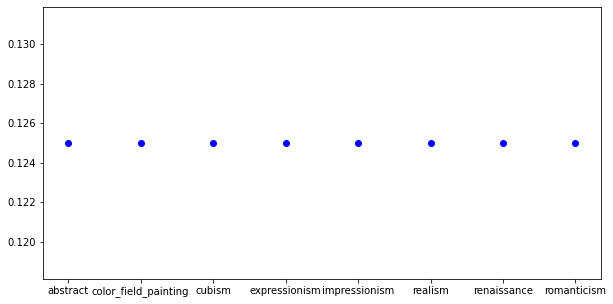

In [23]:
import matplotlib.pyplot as plt
mov_bas=pd.DataFrame(df_train.groupby(by='movement')['file_name'].count()/df_train.shape[0]).reset_index()
plt.figure(figsize=(10, 5))
plt.scatter(x=mov_bas['movement'],y=mov_bas['file_name'],c='b');

In [24]:
baseline_gnd=dict(df_train.groupby(by='genre')['file_name'].count()/df_train.shape[0])
baseline_gnd

{'abstract_painting': 0.24609375,
 'cityscape': 0.04609375,
 'genre_painting': 0.12109375,
 'illustration': 0.02421875,
 'landscape': 0.134375,
 'nude_painting': 0.02890625,
 'portrait': 0.1703125,
 'religious_painting': 0.1,
 'sketch_and_study': 0.0640625,
 'still_life': 0.06484375}

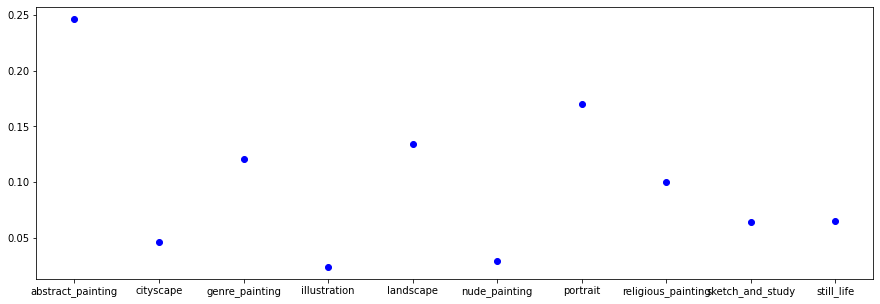

In [25]:
mov_bas=pd.DataFrame(df_train.groupby(by='genre')['file_name'].count()/df_train.shape[0]).reset_index()
plt.figure(figsize=(15, 5))
plt.scatter(x=mov_bas['genre'],y=mov_bas['file_name'],c='b');

## Average and dominant color baseline

### General Fourier Functions

In [26]:
#functions for Fourier Transformation
import numpy
from numpy.fft import fft2, fftshift


def matriceImage(matrice,gamma,rgb):
    s = matrice.shape
    a=1.0/gamma;
    norm=matrice.max()
    m = np.power(matrice/norm,a)
    im = np.zeros((s[0],s[1],3),dtype=float)
    im[:,:,0] = rgb[0]*m
    im[:,:,1] = rgb[1]*m
    im[:,:,2] = rgb[2]*m
    return im

def matriceImageLog(matrice,rgb):
    s = matrice.shape
    m = np.log10(1+matrice)
    min = m.min()
    max = m.max()
    m = (m-min)/(max-min)
    im = numpy.zeros((s[0],s[1],3),dtype=float)
    im[:,:,0] = rgb[0]*m
    im[:,:,1] = rgb[1]*m
    im[:,:,2] = rgb[2]*m
    return im

def plotSpectre(image,Lx,Ly):
    (Ny,Nx,p) = image.shape
    fxm = Nx*1.0/(2*Lx)
    fym = Ny*1.0/(2*Ly)
    plt.imshow(image,extent=[-fxm,fxm,-fym,fym])
    
    plt.xlabel("fx")
    plt.ylabel("fy")

### Function for one image

In [34]:
#Fonction pour une image

def baselines_viz_single(img,n_colors = 5,plot=True,array=True,rgb_fft='g'):

    import cv2 # requires pip install opencv-python

    #resize and flatten
    img_224=np.array(tf.image.resize(img,[224,224]))
    img_pixel = np.float32(img_224.reshape(-1, 3))

    #average color
    avg_color=img_pixel.mean(axis=0)
    img_pixel.shape  

    #Recherche palette dominante et couleur dominante par méthode des kmoyens (sur 5 couleurs par défaut)
    pixels=np.float32(img_pixel)


    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 1000, .5)
    flags = cv2.KMEANS_RANDOM_CENTERS

    _, labels, palette = cv2.kmeans(pixels, n_colors, None, criteria, 10, flags)
    _, counts = np.unique(labels, return_counts=True)
    dom_color = palette[np.argmax(counts)]

    
    #Magnitude Spectrum
    
    rgb_dict={'r':0,'g':1,'b':2}
    
    U=numpy.array(img_224[:,:,rgb_dict[rgb_fft]],dtype=np.float64)
    V=np.fft.fft2(U)
    VC = np.fft.fftshift(V)
    P = np.power(numpy.abs(VC),2)
    img_tff = matriceImageLog(P,[1,0,0])

    
    
    #Viz functions
    avg_patch = np.ones(shape=(224,224,3), dtype=np.uint8)*np.uint8(avg_color)

    indices = np.argsort(counts)[::-1]   
    freqs = np.cumsum(np.hstack([[0], counts[indices]/float(counts.sum())]))
    rows = np.int_(224*freqs)

    dom_patch = np.zeros(shape=(224,224,3), dtype=np.uint8)
    for i in range(len(rows) - 1):
        dom_patch[rows[i]:rows[i + 1], :, :] += np.uint8(palette[indices[i]])

    fig, (ax0, ax1, ax2, ax3, ax4) = plt.subplots(1, 5, figsize=(16,10))
    ax0.imshow(img)
    ax0.set_title('Original Image')
    ax0.axis('off')
    ax1.imshow(np.array(img_224,dtype=int))
    ax1.set_title('Resized Image')
    ax1.axis('off')
    ax2.imshow(avg_patch)
    ax2.set_title('Average color')
    ax2.axis('off')
    ax3.imshow(dom_patch)
    ax3.set_title('Dominant colors')
    ax3.axis('off')
    ax4.imshow(img_tff)
    ax4.set_title('Magnitude Spectrum')
    ax4.axis('off')
    
    #output selection
    
    if plot :
        plt.show(fig)
    
    weights=counts/pixels.shape[0]
    out=None
    if array: 

        img_dict={}
        img_dict['avg_color']=avg_color
        img_dict['dom_color']=palette
        img_dict['dom_weights']=weights
        img_dict['magnitude_spectrum']=img_tff
    
    return img_dict

In [35]:
test=df_train['file_name'].sample(6)
test

177    abstract-expressionism_gerhard-richter_abstrac...
331    color-field-painting_ray-parker_untitled-1967-...
622    expressionism_richard-diebenkorn_lemons-and-ja...
117    abstract-expressionism_mark-tobey_canticle-195...
742    expressionism_max-pechstein_village-landscape-...
389    color-field-painting_ellsworth-kelly_boats-in-...
Name: file_name, dtype: object

In [36]:
paintings_sample=['expressionism_jean-paul-lemieux_jeune-fille-au-chandail-rouge-1974.jpg',
'expressionism_ernst-ludwig-kirchner_mountains-and-houses-in-the-snow.jpg',
'expressionism_oskar-kokoschka_not_detected_235840.jpg',
'impressionism_pierre-auguste-renoir_head-of-a-woman-1913.jpg',
'abstract-expressionism_esteban-vicente_orange-red-black-1962.jpg',
'northern-renaissance_hans-holbein-the-younger_studies-of-the-hands-of-erasmus-of-rotterdam.jpg',
'impressionism_edmund-charles-tarbell_profile-1900.jpg',
'cubism_pablo-picasso_portrait-of-manuel-pallares-1909.jpg',
'expressionism_august-macke_sketch-of-the-bridge.jpg'
]

In [37]:
test_img1=plt.imread(MAIN_PATH+IMAGES+'/'+paintings_sample[0])
test_img2=plt.imread(MAIN_PATH+IMAGES+'/'+paintings_sample[1])
test_img3=plt.imread(MAIN_PATH+IMAGES+'/'+paintings_sample[2])
test_img4=plt.imread(MAIN_PATH+IMAGES+'/'+paintings_sample[3])
test_img5=plt.imread(MAIN_PATH+IMAGES+'/'+paintings_sample[4])
test_img6=plt.imread(MAIN_PATH+IMAGES+'/'+paintings_sample[5])
test_img7=plt.imread(MAIN_PATH+IMAGES+'/'+paintings_sample[6])
test_img8=plt.imread(MAIN_PATH+IMAGES+'/'+paintings_sample[7])
test_img9=plt.imread(MAIN_PATH+IMAGES+'/'+paintings_sample[8])

In [31]:
test_img1.shape

(603, 325, 3)

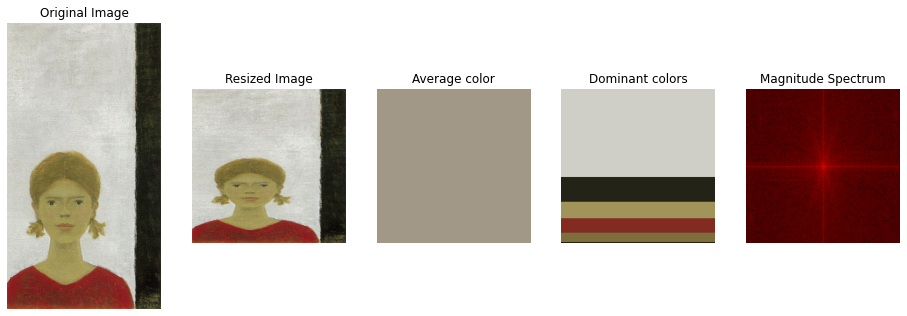

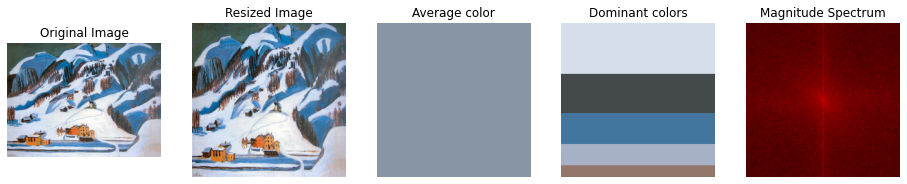

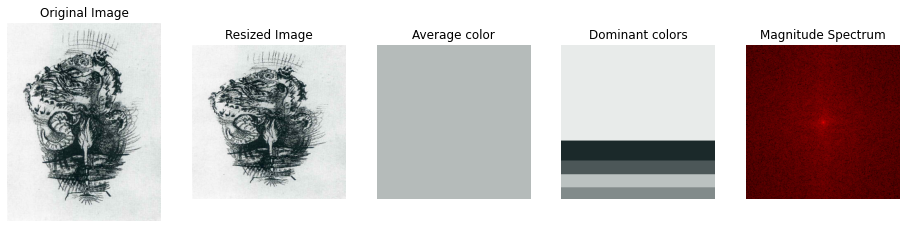

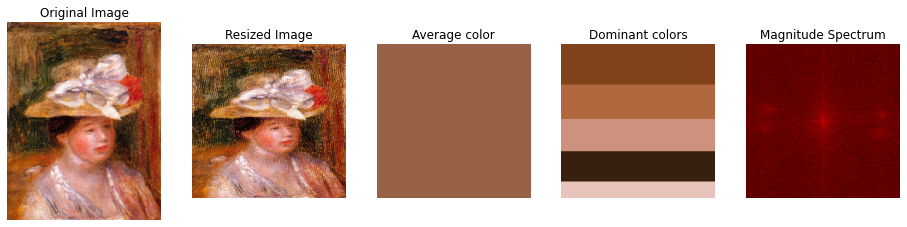

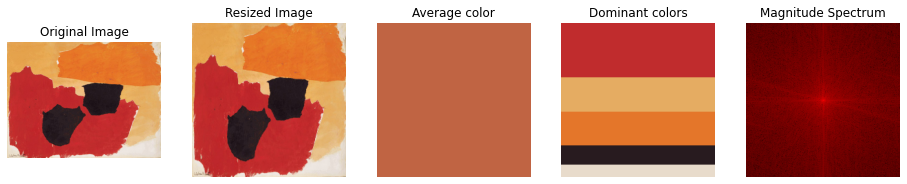

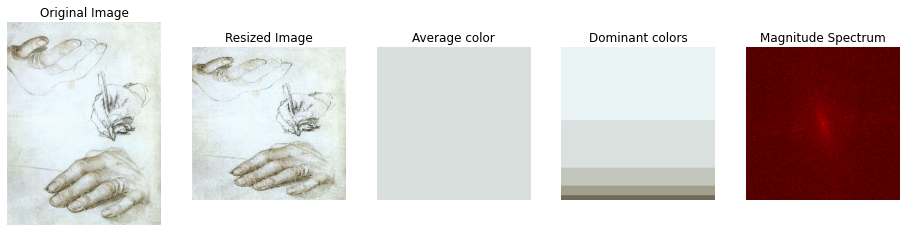

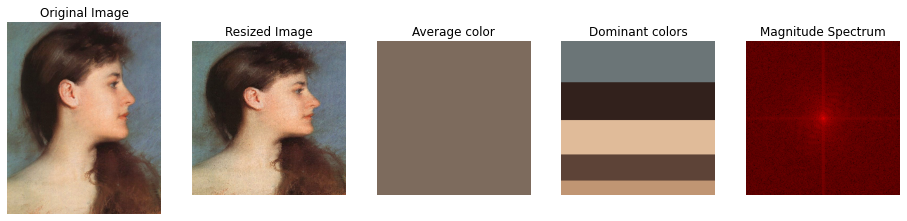

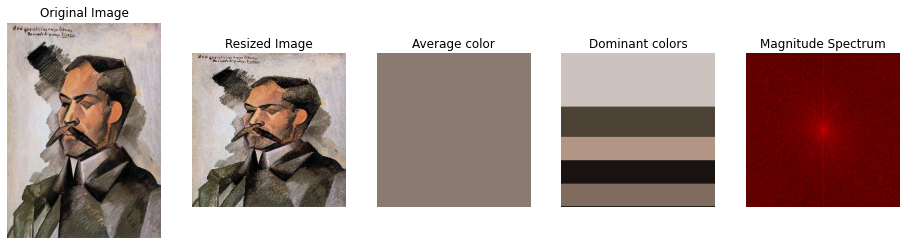

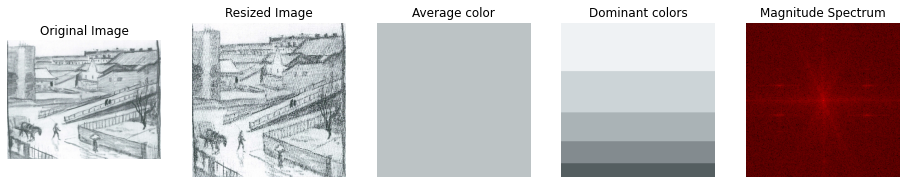

In [38]:
img1_col=baselines_viz_single(test_img1,array=True)
img2_col=baselines_viz_single(test_img2,array=True)
img3_col=baselines_viz_single(test_img3,array=True)
img4_col=baselines_viz_single(test_img4,array=True)
img5_col=baselines_viz_single(test_img5,array=True)
img6_col=baselines_viz_single(test_img6,array=True)
img7_col=baselines_viz_single(test_img7,array=True)
img8_col=baselines_viz_single(test_img8,array=True)
img9_col=baselines_viz_single(test_img9,array=True)

### Function for a dataset of images or a movement

In [39]:

def baselines_viz_mov(df,root,mov,n_colors = 5,plot=True,array=True,rgb_fft='g'):

    '''
    df : DataFrame ; initial dataframe with filename and movement
    mov : String ; chosen movement for baseline observation
    plot : Bool ; chose to print the colors when executing the function
    plot : Bool ; returns the arrays for colors : (avg_color,palette)
    
    '''
    
    path_list=df['file_name'][df['movement']==mov]
    pixels=np.empty(3)
    fourier_img=np.zeros((224,224, 3))
    for file in list(path_list):
        #average and dominant colors :
        #images are reshaped to 224X224 and pixels are stacked next to each other
        path=root+file
        img=plt.imread(path)
        img_224=np.array(tf.image.resize(img,[224,224]))
        img_pixel = np.float32(img_224.reshape(-1, 3))
        pixels=np.vstack((pixels,img_pixel))
        
        #Fourier transfo : average value for each image inside the movement
        #f = np.fft.fft2(img_224,)
        #fshift = np.fft.fftshift(f)
        #np.seterr(divide = 'ignore') 
        #fourier_img += 75*np.log(np.abs(fshift))
        #np.seterr(divide = 'warn')

            #Magnitude Spectrum
    
        rgb_dict={'r':0,'g':1,'b':2}
    
        U=numpy.array(img_224[:,:,rgb_dict[rgb_fft]],dtype=np.float64)
        V=np.fft.fft2(U)
        VC = np.fft.fftshift(V)
        P = np.power(numpy.abs(VC),2)
        img_tff = matriceImageLog(P,[1,0,0])
        fourier_img += img_tff
        
    avg_color=pixels.mean(axis=0)


    #Recherche palette dominante et couleur dominante par méthode des kmoyens (sur 5 couleurs par défaut)
    #premier pixel était là pour initialiser, il faut le virer
    pixels=np.float32(pixels)[1:]

    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10000, .5)
    flags = cv2.KMEANS_RANDOM_CENTERS

    _, labels, palette = cv2.kmeans(pixels, n_colors, None, criteria, 10, flags)
    _, counts = np.unique(labels, return_counts=True)
    dom_color = palette[np.argmax(counts)]

        ##Magnitude Spectrum

    magnitude_spectrum = fourier_img/len(path_list)
        
        #Viz functions
    avg_patch = np.ones(shape=(224,224,3), dtype=np.uint8)*np.uint8(avg_color)

    indices = np.argsort(counts)[::-1]   
    freqs = np.cumsum(np.hstack([[0], counts[indices]/float(counts.sum())]))
    rows = np.int_(224*freqs)

    dom_patch = np.zeros(shape=(224,224,3), dtype=np.uint8)
    for i in range(len(rows) - 1):
        dom_patch[rows[i]:rows[i + 1], :, :] += np.uint8(palette[indices[i]])
        
        
    fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(16,10))
    ax0.imshow(avg_patch)
    ax0.set_title(mov.capitalize()+' - Average color')
    ax0.axis('off')
    ax1.imshow(dom_patch)
    ax1.set_title(mov.capitalize()+' - Dominant colors')
    ax1.axis('off')
    ax2.imshow(magnitude_spectrum, cmap = 'gray')
    ax2.set_title('Magnitude Spectrum')
    ax2.axis('off')
    plt.show(fig)

    #output selection
    
    if plot :
        plt.show(fig)
    

    weights=counts/pixels.shape[0]
    out=None
    if array: 
        out =(avg_color,palette,weights,magnitude_spectrum)
    
    return out
    

##### Test on a specific movement : expressionism

In [40]:
mov_test='expressionism'
test2=df_train[df_train['movement']==mov_test]['file_name'][0:6]
test2

600              expressionism_balthus_the-room-1948.jpg
601    expressionism_edvard-munch_the-four-sons-of-dr...
603    expressionism_neil-welliver_couple-with-leslie...
604    expressionism_nicolae-tonitza_unknown-title-2.jpg
605    expressionism_elaine-de-kooning_pele-no-1-1982...
606    expressionism_august-macke_sketch-of-the-bridg...
Name: file_name, dtype: object

In [41]:
test2_img1=plt.imread(MAIN_PATH+IMAGES+'/'+test2[test2.index[0]])
test2_img2=plt.imread(MAIN_PATH+IMAGES+'/'+test2[test2.index[1]])
test2_img3=plt.imread(MAIN_PATH+IMAGES+'/'+test2[test2.index[2]])
test2_img4=plt.imread(MAIN_PATH+IMAGES+'/'+test2[test2.index[3]])
test2_img5=plt.imread(MAIN_PATH+IMAGES+'/'+test2[test2.index[4]])
test2_img6=plt.imread(MAIN_PATH+IMAGES+'/'+test2[test2.index[5]])


In [42]:
print(test2[test2.index[1]])

expressionism_edvard-munch_the-four-sons-of-dr-linde-1903.jpg


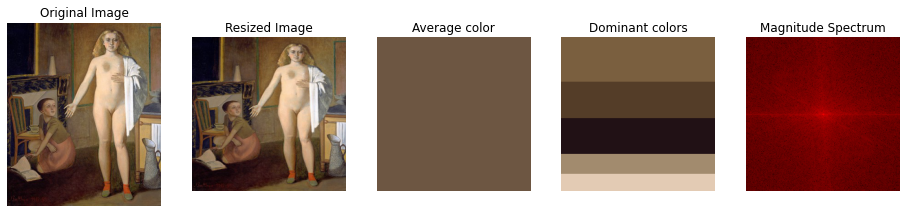

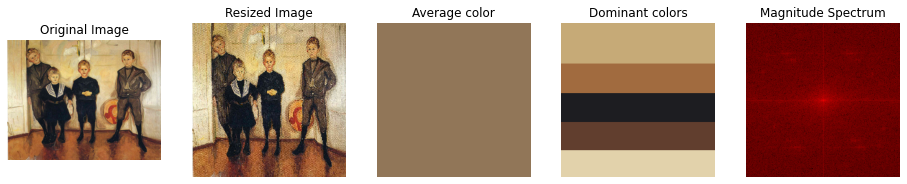

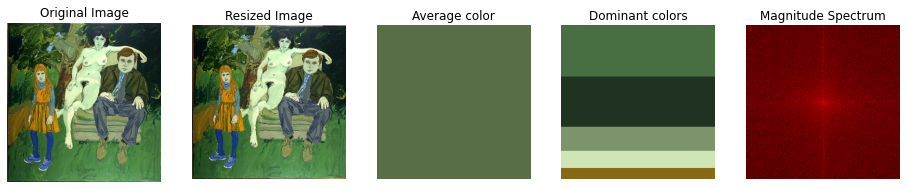

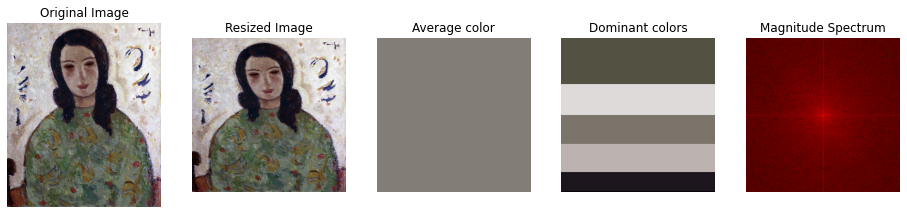

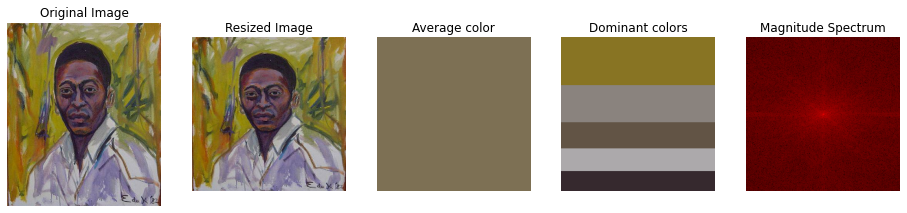

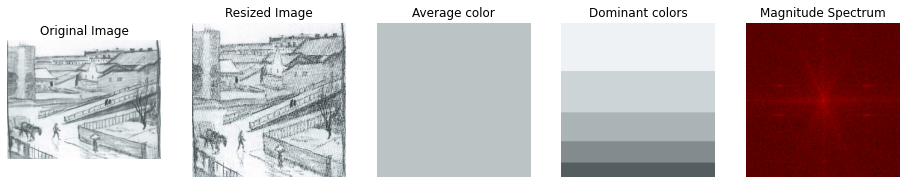

In [43]:
img1_col=baselines_viz_single(test2_img1,array=True)
img2_col=baselines_viz_single(test2_img2,array=True)
img3_col=baselines_viz_single(test2_img3,array=True)
img4_col=baselines_viz_single(test2_img4,array=True)
img5_col=baselines_viz_single(test2_img5,array=True)
img6_col=baselines_viz_single(test2_img6,array=True)

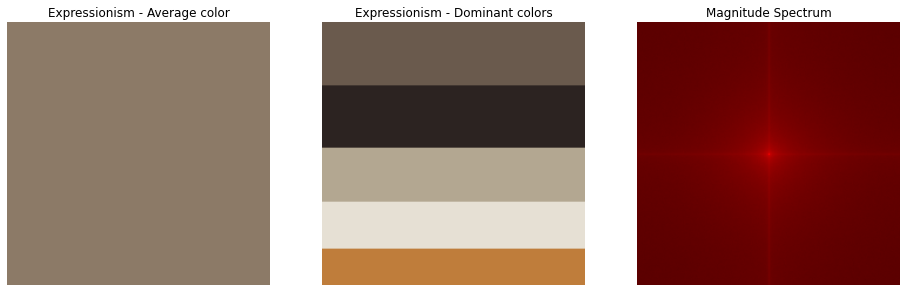

(array([140.98122556, 122.49179619, 103.15285917]),
 array([[179.99889 , 167.09987 , 145.58406 ],
        [230.72943 , 224.99802 , 212.58818 ],
        [ 44.53045 ,  35.903313,  33.511322],
        [106.63073 ,  90.63535 ,  77.009926],
        [191.56712 , 125.09795 ,  59.835567]], dtype=float32),
 array([0.20492616, 0.18182298, 0.23543407, 0.24268844, 0.13512835]),
 array([[[0.34038038, 0.        , 0.        ],
         [0.35719854, 0.        , 0.        ],
         [0.35957411, 0.        , 0.        ],
         ...,
         [0.3593547 , 0.        , 0.        ],
         [0.35957411, 0.        , 0.        ],
         [0.35719854, 0.        , 0.        ]],
 
        [[0.35644398, 0.        , 0.        ],
         [0.36211709, 0.        , 0.        ],
         [0.36000566, 0.        , 0.        ],
         ...,
         [0.36097529, 0.        , 0.        ],
         [0.36106855, 0.        , 0.        ],
         [0.36374239, 0.        , 0.        ]],
 
        [[0.35448863, 0.        ,

In [44]:
baseline_expressionism=baselines_viz_mov(df,root,'expressionism',5)
baseline_expressionism

**Create baseline dict**

In [45]:
#function to calculate baseline dictionnary of colors

root=MAIN_PATH + IMAGES + '/'

def baseline_dict(df,root,n_colors=5):

    mov_list=list(df['movement'].unique())
    base_dict={}
    for mov in mov_list:
        mov_dict={}
        baseline=baselines_viz_mov(df,root,mov,n_colors,plot=False,array=True)
        mov_dict['avg_color']=baseline[0]
        mov_dict['dom_color']=baseline[1]
        mov_dict['dom_weights']=baseline[2]
        mov_dict['mov_fft']=baseline[3]
        base_dict[mov]=mov_dict
    
    return base_dict

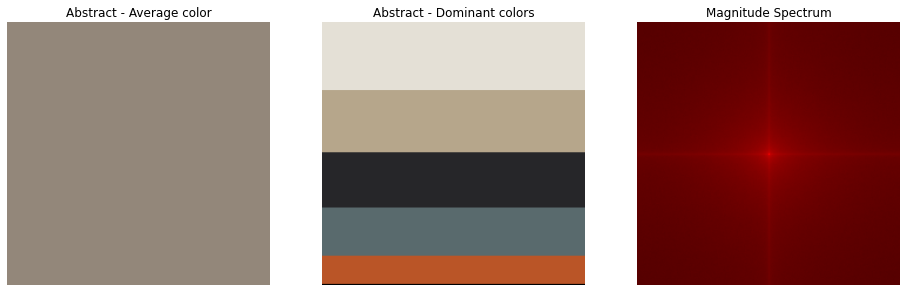

/usr/local/Caskroom/miniforge/base/envs/lewagon/lib/python3.7/site-packages/PIL/Image.py:2914: DecompressionBombWarning: Image size (107327830 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


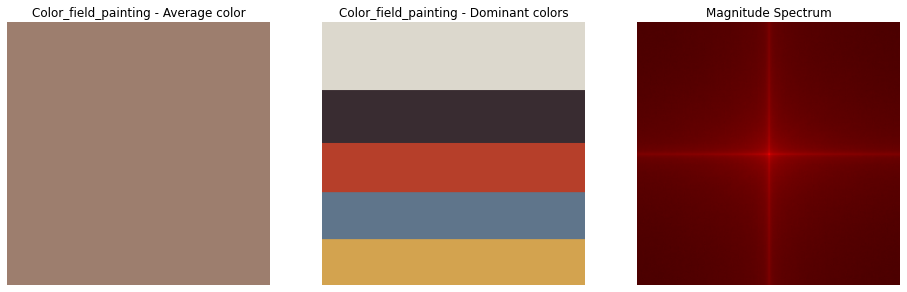

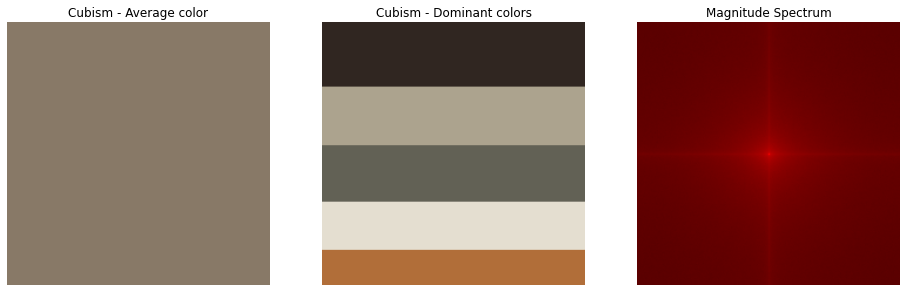

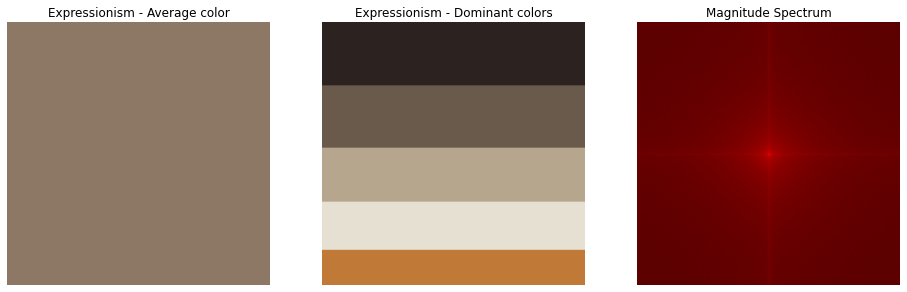

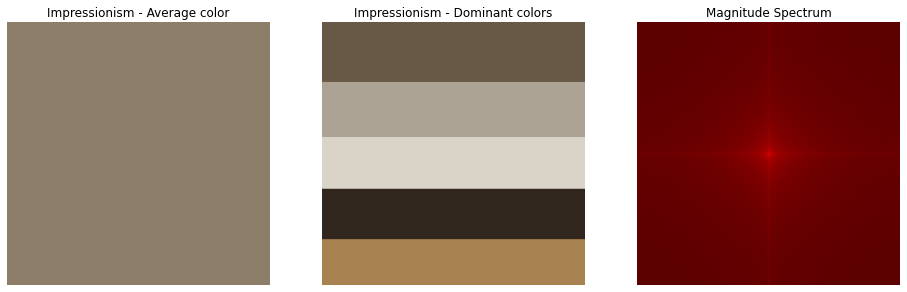

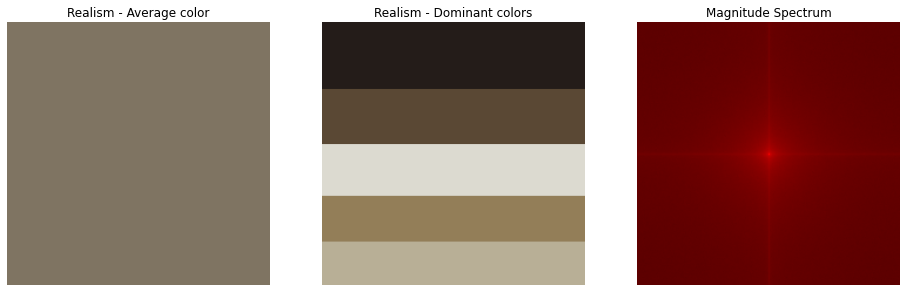

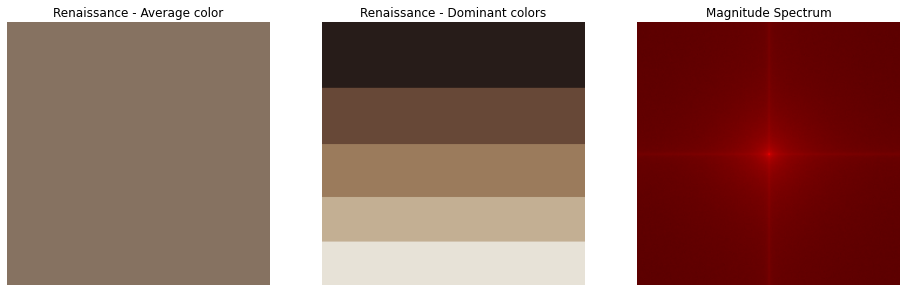

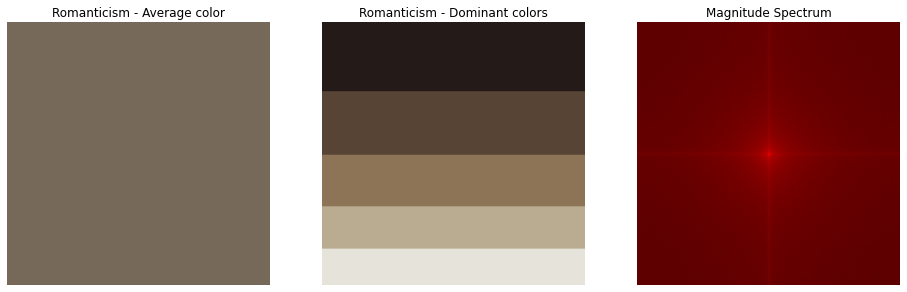

In [46]:
base_dict=baseline_dict(df_train,root,5)


In [47]:
base_dict

{'abstract': {'avg_color': array([147.98827658, 135.12015556, 122.22992934]),
  'dom_color': array([[228.84145 , 224.57289 , 214.8127  ],
         [ 89.5918  , 106.04816 , 109.91471 ],
         [ 38.85765 ,  38.691685,  41.086285],
         [182.11938 , 166.98952 , 139.23358 ],
         [186.24733 ,  85.34914 ,  39.859467]], dtype=float32),
  'dom_weights': array([0.26309516, 0.18450118, 0.2076137 , 0.23467843, 0.11011153]),
  'mov_fft': array([[[0.30791984, 0.        , 0.        ],
          [0.3373879 , 0.        , 0.        ],
          [0.34100676, 0.        , 0.        ],
          ...,
          [0.33761857, 0.        , 0.        ],
          [0.34100676, 0.        , 0.        ],
          [0.3373879 , 0.        , 0.        ]],
  
         [[0.34117009, 0.        , 0.        ],
          [0.33285857, 0.        , 0.        ],
          [0.34430705, 0.        , 0.        ],
          ...,
          [0.33647697, 0.        , 0.        ],
          [0.34878682, 0.        , 0.        ]

## Compute loss function for average color

In [53]:
y_pred_exp=base_dict['expressionism']['avg_color']
y_pred_cfp=base_dict['color_field_painting']['avg_color']
y=avg_color

print(y,y_pred_exp,y_pred_cfp)


[157.53006768 126.61784219 110.23613514] [140.8277864  120.78903265 100.77163771] [157.53005281 126.61782911 110.23612398]


##### quick test (can only be executed after running a movement example)

In [54]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, max_error
import math

mse = mean_squared_error(y, y_pred_exp)
mse2 = mean_squared_error(y, y_pred_cfp)

rmse = math.sqrt(mse)
rmse2 = math.sqrt(mse2)

mae = mean_absolute_error(y, y_pred_exp)
mae2 = mean_absolute_error(y, y_pred_cfp)

rsquared = r2_score(y, y_pred_exp)
rsquared2 = r2_score(y, y_pred_cfp)

max_err = max_error(y, y_pred_exp)
max_err2 = max_error(y, y_pred_cfp)

print('Comparison to expressionism')
print('MSE =', round(mse, 2))
print('RMSE =', round(rmse, 2))
print('MAE =', round(mae, 2))
print('R2 =', round(rsquared, 2))
print('Max Error =', round(max_err, 2))
print('\n')
print('Comparison to color field painting')
print('MSE =', round(mse2, 2))
print('RMSE =', round(rmse2, 2))
print('MAE =', round(mae2, 2))
print('R2 =', round(rsquared2, 2))
print('Max Error =', round(max_err2, 2))


Comparison to expressionism
MSE = 134.17
RMSE = 11.58
MAE = 10.67
R2 = 0.65
Max Error = 16.7


Comparison to color field painting
MSE = 0.0
RMSE = 0.0
MAE = 0.0
R2 = 1.0
Max Error = 0.0


In [55]:
base_pred_avg(y,base_dict)

'color_field_painting'

##### function

In [56]:
#try on mae :

from sklearn.metrics import mean_absolute_error

y=img1_col['avg_color']

def base_pred_avg(avg_color,base_dict):

    mov_list=list(base_dict.keys())

    loss_dict={}     

    for mov in mov_list:
        loss_dict[mov]=mean_absolute_error(avg_color, base_dict[mov]['avg_color'])
        
    return min(loss_dict, key=loss_dict.get)
    

## Compute loss function for dominant color

In [50]:
def base_pred_dom(img,base_dict,n_colors=5):

    '''
    Description : movement prediction based on dominant colors
    
    '''
    #each color gets compared to dominant colors of every movement
    #rating is done using MAE weighted by the inverse of dominance weights
    #minimal weighted distance is then used as a loss

    mov_list=list(base_dict.keys())

    loss_dict={}

    for mov in mov_list:
        loss_mov=0
        for color_dom in list(range(0,n_colors)):
            loss_list=[]
            for color_mov in list(range(0,n_colors)):
                loss_list.append((base_dict[mov]['dom_weights'][color_mov]*img['dom_weights'][color_dom])**-1 *\
                    mean_absolute_error(img['dom_color'][color_dom]/255,base_dict[mov]['dom_color'][color_mov]/255))
            loss_mov+=min(loss_list)
        loss_dict[mov]=loss_mov    

    return min(loss_dict, key=loss_dict.get)

In [51]:
print(base_pred_dom(img1_col,base_dict,n_colors))
print(base_pred_dom(img2_col,base_dict,n_colors))
print(base_pred_dom(img3_col,base_dict,n_colors))
print(base_pred_dom(img4_col,base_dict,n_colors))
print(base_pred_dom(img5_col,base_dict,n_colors))
print(base_pred_dom(img6_col,base_dict,n_colors))

realism
realism
impressionism
romanticism
impressionism
cubism


### Check of function prediction on dominant colors images of movements

/usr/local/Caskroom/miniforge/base/envs/lewagon/lib/python3.7/site-packages/PIL/Image.py:2914: DecompressionBombWarning: Image size (107327830 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  DecompressionBombWarning,


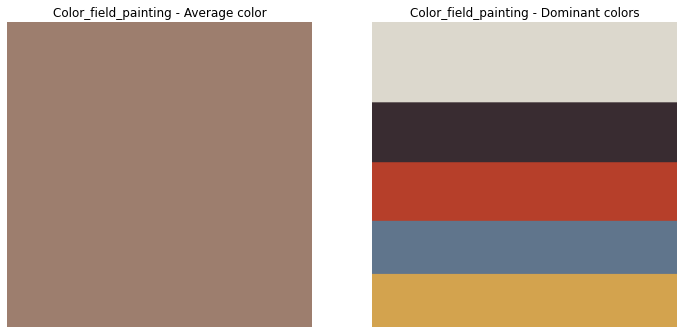

In [52]:
mov='color_field_painting'
n_colors=5
df=df_train
root=MAIN_PATH+IMAGES+'/'


    
path_list=df['file_name'][df['movement']==mov]
pixels=np.empty(3)
for file in list(path_list):
#images are reshaped to 224X224 and pixels are stacked next to each other
    path=root+file
    img=plt.imread(path)
    img_224=np.array(tf.image.resize(img,[224,224]))
    img_pixel = np.float32(img_224.reshape(-1, 3))
    pixels=np.vstack((pixels,img_pixel))

avg_color=pixels.mean(axis=0)


#Recherche palette dominante et couleur dominante par méthode des kmoyens (sur 5 couleurs par défaut)
#premier pixel était là pour initialiser, il faut le virer
pixels=np.float32(pixels)[1:]

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10000, .5)
flags = cv2.KMEANS_RANDOM_CENTERS

_, labels, palette = cv2.kmeans(pixels, n_colors, None, criteria, 10, flags)
_, counts = np.unique(labels, return_counts=True)
dom_color_cfp = palette[np.argmax(counts)]

    #Viz functions
avg_patch = np.ones(shape=(224,224,3), dtype=np.uint8)*np.uint8(avg_color)

indices = np.argsort(counts)[::-1]   
freqs = np.cumsum(np.hstack([[0], counts[indices]/float(counts.sum())]))
rows = np.int_(224*freqs)

dom_patch_cfp = np.zeros(shape=(224,224,3), dtype=np.uint8)
for i in range(len(rows) - 1):
    dom_patch_cfp[rows[i]:rows[i + 1], :, :] += np.uint8(palette[indices[i]])


fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(12,6))
ax0.imshow(avg_patch)
ax0.set_title(mov.capitalize()+' - Average color')
ax0.axis('off')
ax1.imshow(dom_patch_cfp)
ax1.set_title(mov.capitalize()+' - Dominant colors')
ax1.axis('off')
plt.show(fig) 

#output selection

plt.show(fig)


weights=counts/pixels.shape[0]
out=None
out =(avg_color,palette,weights)


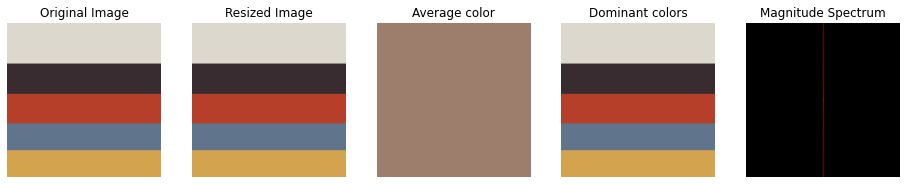

In [57]:
img_cfp=baselines_viz_single(dom_patch_cfp,array=True)

In [58]:
print(base_pred_dom(img_cfp,base_dict,n_colors))

color_field_painting


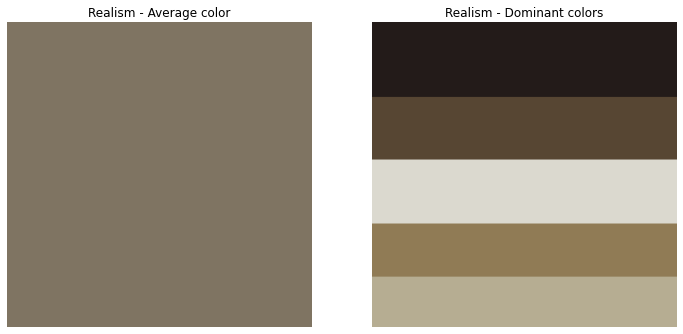

In [59]:
mov='realism'
n_colors=5
df=df_train
root=MAIN_PATH+IMAGES+'/'


    
path_list=df['file_name'][df['movement']==mov]
pixels=np.empty(3)
for file in list(path_list):
#images are reshaped to 224X224 and pixels are stacked next to each other
    path=root+file
    img=plt.imread(path)
    img_224=np.array(tf.image.resize(img,[224,224]))
    img_pixel = np.float32(img_224.reshape(-1, 3))
    pixels=np.vstack((pixels,img_pixel))

avg_color=pixels.mean(axis=0)


#Recherche palette dominante et couleur dominante par méthode des kmoyens (sur 5 couleurs par défaut)
#premier pixel était là pour initialiser, il faut le virer
pixels=np.float32(pixels)[1:]

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10000, .5)
flags = cv2.KMEANS_RANDOM_CENTERS

_, labels, palette = cv2.kmeans(pixels, n_colors, None, criteria, 10, flags)
_, counts = np.unique(labels, return_counts=True)
dom_color_realism = palette[np.argmax(counts)]

    #Viz functions
avg_patch = np.ones(shape=(224,224,3), dtype=np.uint8)*np.uint8(avg_color)

indices = np.argsort(counts)[::-1]   
freqs = np.cumsum(np.hstack([[0], counts[indices]/float(counts.sum())]))
rows = np.int_(224*freqs)

dom_patch_realism = np.zeros(shape=(224,224,3), dtype=np.uint8)
for i in range(len(rows) - 1):
    dom_patch_realism[rows[i]:rows[i + 1], :, :] += np.uint8(palette[indices[i]])


fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(12,6))
ax0.imshow(avg_patch)
ax0.set_title(mov.capitalize()+' - Average color')
ax0.axis('off')
ax1.imshow(dom_patch_realism)
ax1.set_title(mov.capitalize()+' - Dominant colors')
ax1.axis('off')
plt.show(fig) 

#output selection

plt.show(fig)


weights=counts/pixels.shape[0]
out=None
out =(avg_color,palette,weights)


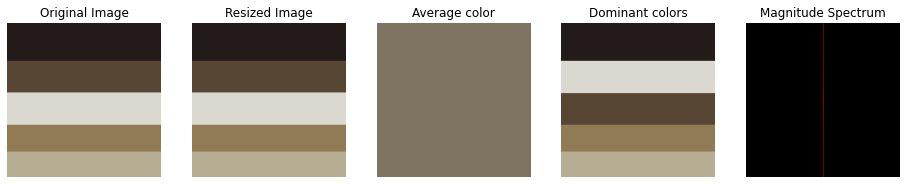

In [60]:
img_realism=baselines_viz_single(dom_patch_realism,array=True)

In [61]:
print(base_pred_dom(img_realism,base_dict,n_colors))

realism


## Compute loss function from Fourier Transformation

##### Check of Fourier Transformation error computation

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14403.998659251161

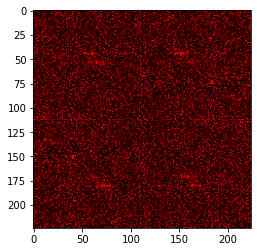

In [62]:
mean_ms=5*np.abs((img3_col['magnitude_spectrum']-img2_col['magnitude_spectrum']))
plt.imshow(mean_ms, cmap = 'gray')

mean_ms.sum()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14882.14075189942

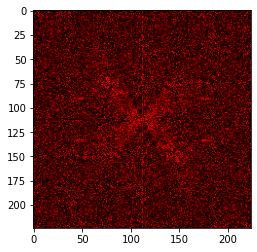

In [63]:
mean_ms=5*np.abs((img6_col['magnitude_spectrum']-img4_col['magnitude_spectrum']))
plt.imshow(mean_ms, cmap = 'gray')
mean_ms.sum()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(0.0, 1.0, 0.0, 1.0)

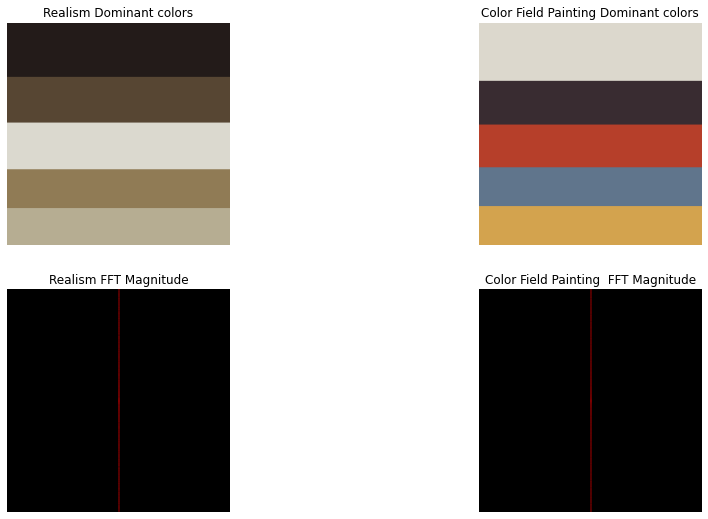

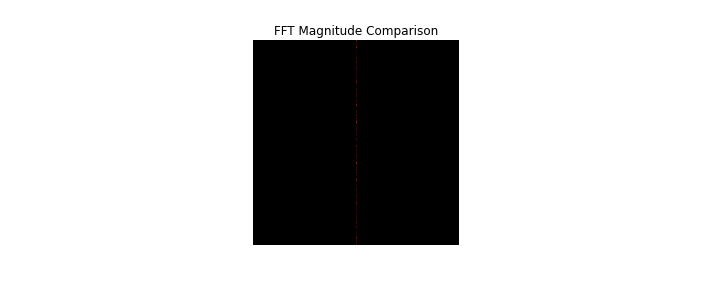

In [65]:
# coeff of 5 seems to be enough to illustrate differences in shapes

mean_ms=6*np.abs((img_realism['magnitude_spectrum']-img_cfp['magnitude_spectrum']))


fig1, ((ax0, ax1),(ax2, ax3)) = plt.subplots(2, 2, figsize=(15.5,9))
ax0.imshow(dom_patch_realism)
ax0.set_title('Realism Dominant colors')
ax0.axis('off')
ax1.imshow(dom_patch_cfp)
ax1.set_title('Color Field Painting Dominant colors')
ax1.axis('off')
ax2.imshow(img_realism['magnitude_spectrum'])
ax2.set_title('Realism FFT Magnitude')
ax2.axis('off')
ax3.imshow(img_cfp['magnitude_spectrum'])
ax3.set_title('Color Field Painting  FFT Magnitude')
ax3.axis('off')

fig2, (ax0,ax1,ax2) = plt.subplots(1, 3, figsize=(12.5,5))
ax0.axis('off')

ax1.imshow(mean_ms, cmap = 'gray')
ax1.set_title('FFT Magnitude Comparison')
ax1.axis('off')

ax2.axis('off')



In [66]:
def base_pred_fft(img,base_dict):
    
    mov_list=list(base_dict.keys())

    loss_dict={}

    for mov in mov_list:
        loss_dict[mov]=5*np.abs(img['magnitude_spectrum']-base_dict[mov]['mov_fft']).sum()
        
    return min(loss_dict, key=loss_dict.get)
    

In [67]:
print(base_pred_fft(img1_col,base_dict))
print(base_pred_fft(img2_col,base_dict))
print(base_pred_fft(img3_col,base_dict))
print(base_pred_fft(img4_col,base_dict))
print(base_pred_fft(img5_col,base_dict))
print(base_pred_fft(img6_col,base_dict))
            

renaissance
renaissance
expressionism
abstract
abstract
impressionism


# Baseline Predictions

In [68]:
# Prediction function for baseline's accuracies

def baseline_accuracy(df,base_dict):

    test_pred=df.copy()
    test_pred['avg_color_pred']=''
    test_pred['dom_color_pred']=''
    test_pred['fft_pred']=''
    
    for paint in test_pred['file_name'].index:
        img=plt.imread(MAIN_PATH+IMAGES+'/'+test_pred.loc[paint]['file_name'])
        baseline=baselines_viz_single(img,plot=False)
        test_pred.loc[paint,'avg_color_pred']=(base_pred_avg(baseline['avg_color'],base_dict)==test_pred.loc[paint,'movement'])
        test_pred.loc[paint,'dom_color_pred']=(base_pred_dom(baseline,base_dict,5)==test_pred.loc[paint,'movement'])
        test_pred.loc[paint,'fft_pred']=(base_pred_fft(baseline,base_dict)==test_pred.loc[paint,'movement'])

    baseline_pred_accuracy={'avg_color_pred':test_pred['avg_color_pred'].sum()/test_pred.shape[0],
                        'dom_color_pred':test_pred['dom_color_pred'].sum()/test_pred.shape[0],
                        'fft_pred':test_pred['fft_pred'].sum()/test_pred.shape[0]}

    return baseline_pred_accuracy


/usr/local/Caskroom/miniforge/base/envs/lewagon/lib/python3.7/site-packages/ipykernel_launcher.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


{'avg_color_pred': 0.1625, 'dom_color_pred': 0.20625, 'fft_pred': 0.25}

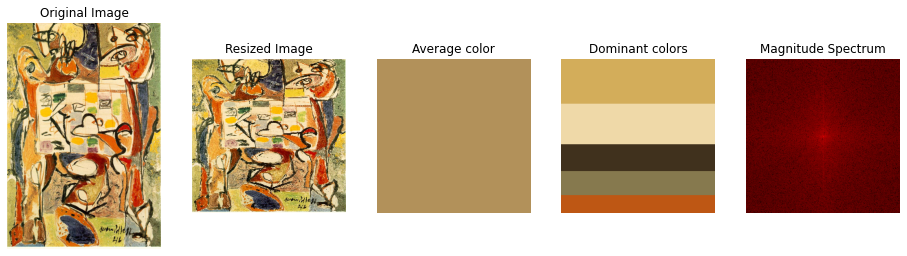

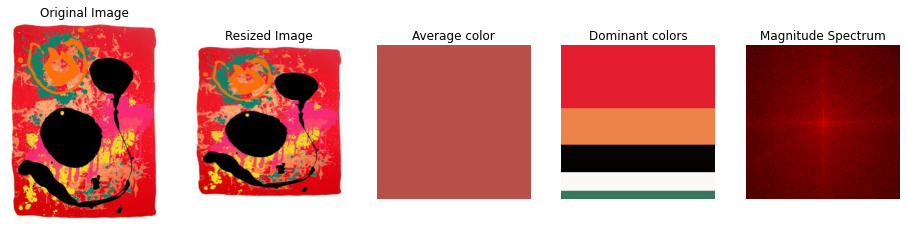

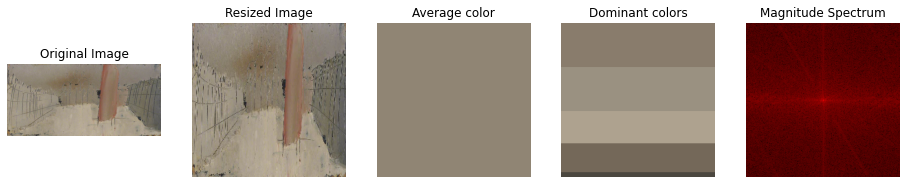

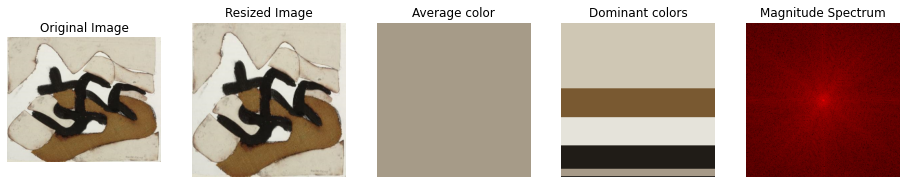

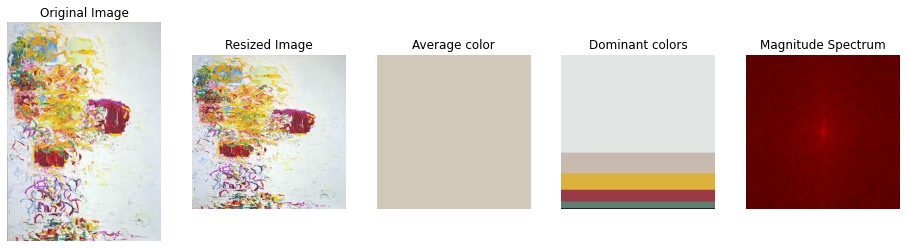

...

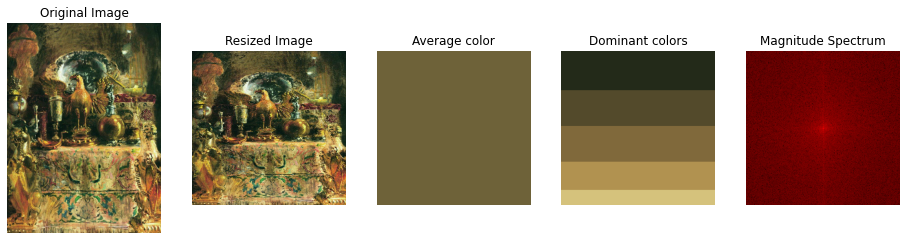

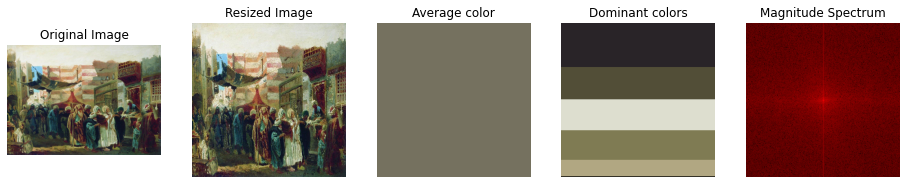

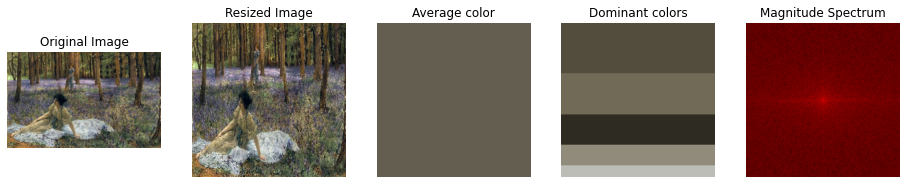

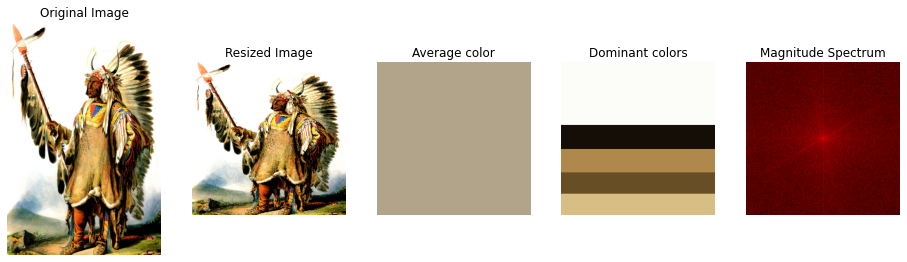

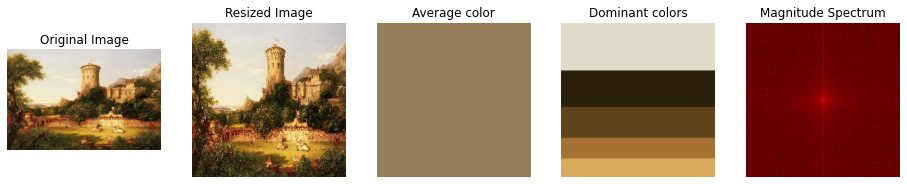

In [71]:
baseline_accuracy(df_test,base_dict)